In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium

# Cargar los datos
houses = pd.read_csv('housing.csv')

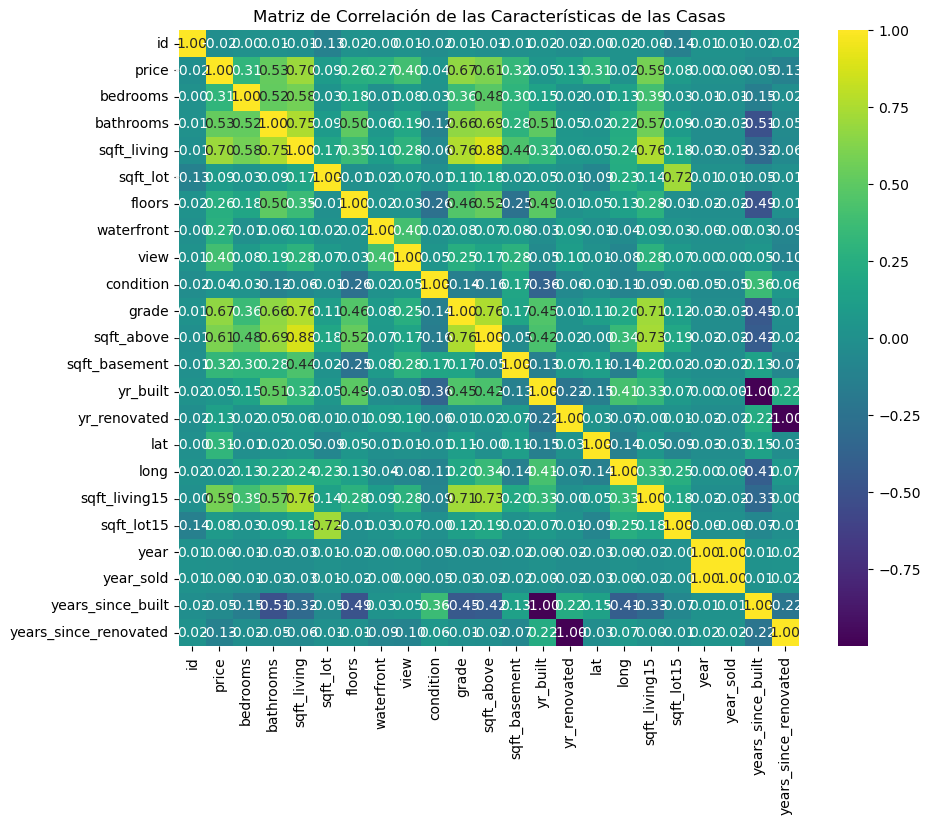

In [65]:
# Eliminar las columnas no numéricas o convertirlas a numéricas si es posible
houses_numeric = houses.select_dtypes(include=[np.number])

# Calcular la matriz de correlación
correlation_matrix = houses_numeric.corr()

# Generar el heatmap utilizando seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")
plt.title('Matriz de Correlación de las Características de las Casas')
plt.show()



In [3]:
houses.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [15]:
from folium.plugins import MarkerCluster
# Create a 2d Plot of the houses with color based on the price, do it zoomeable, but always showing the houses

houses_map = folium.Map(location=[houses['lat'].mean(), houses['long'].mean()], zoom_start=10)

# Add a marker for each house
marker_cluster = MarkerCluster().add_to(houses_map)
#Add the color in a red to green scale
for idx, row in houses.iterrows():
    folium.Marker([row['lat'], row['long']], popup=f"Price: {row['price']}",
                  icon=folium.Icon(color='green' if row['price'] > houses['price'].mean() else 'red')).add_to(marker_cluster)
    
# Add a layer control to the map
folium.LayerControl().add_to(houses_map)

# Display the map
houses_map.save('houses_map_colors.html')
houses_map

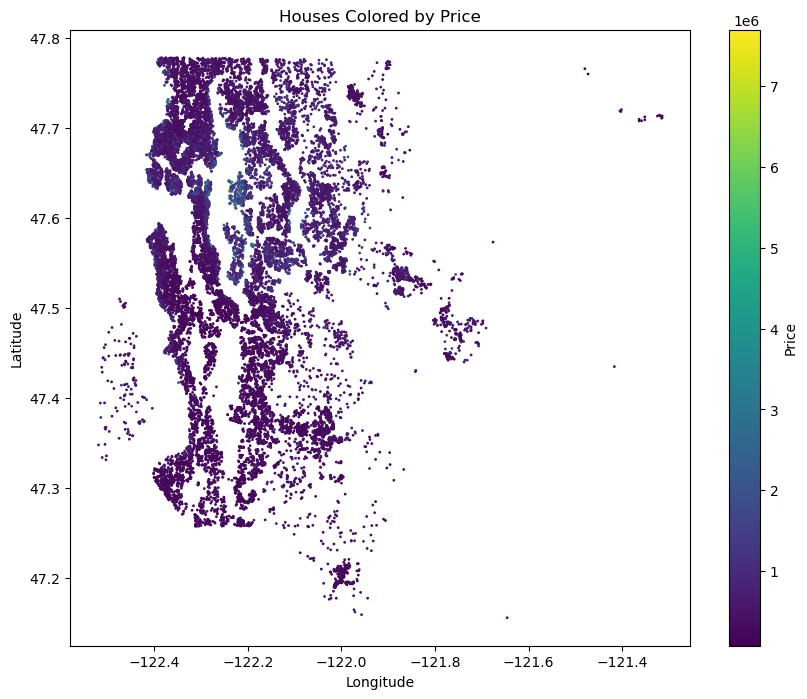

In [25]:
# Create a 2d Plot of the houses with color based on the price in matplotlib
plt.figure(figsize=(10, 8))
plt.scatter(houses['long'], houses['lat'], c=houses['price'], cmap='viridis', s=1)
plt.colorbar().set_label('Price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Houses Colored by Price')
plt.show()


De este mapa podemos observar varias cosas interesantes, notese que las casas pegadas a los rios tienden a ser mas caras, ademas hay una zona mas centrica, donde los precios tienden a ser mas caros

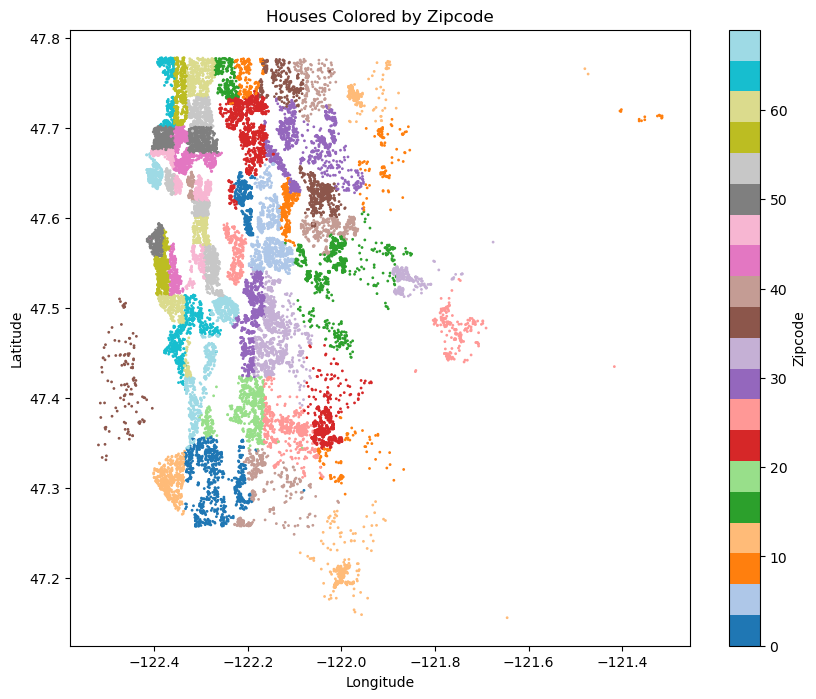

In [31]:
import matplotlib.pyplot as plt
#Create a 2D Plot of the zipcodes in the map, in matplotlib
houses['zipcode'] = houses['zipcode'].astype('category')
plt.figure(figsize=(10, 8))
plt.scatter(houses['long'], houses['lat'], c=houses['zipcode'].cat.codes, cmap='tab20', s=1)
plt.colorbar().set_label('Zipcode')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Houses Colored by Zipcode')
plt.show()


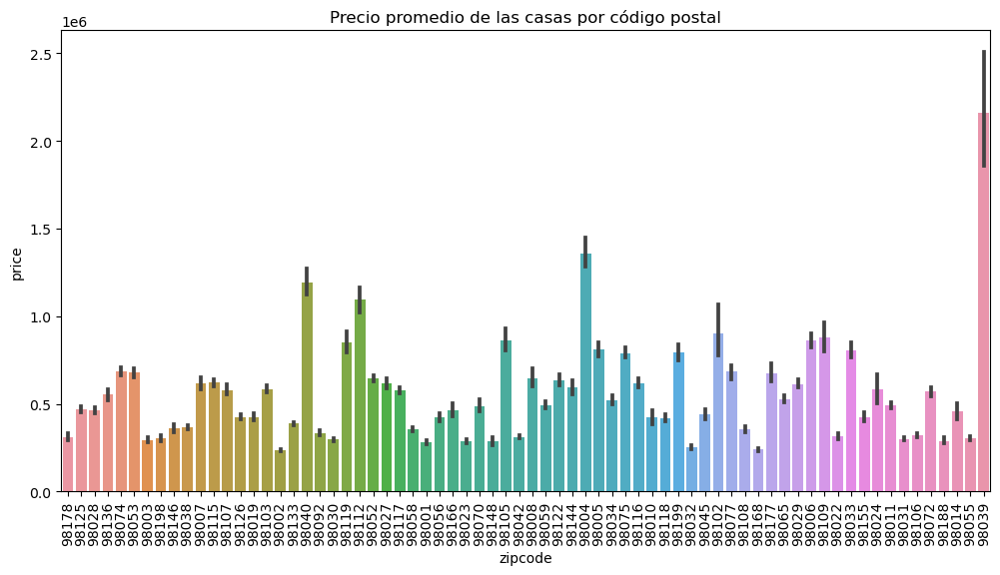

In [17]:
#Showme [postal code, price] in a bar chart
houses['zipcode'] = houses['zipcode'].astype(str)

plt.figure(figsize=(12, 6))
sns.barplot(x='zipcode', y='price', data=houses)
plt.title('Precio promedio de las casas por código postal')
plt.xticks(rotation=90)
plt.show()


Tambien podemos ver que hay zonas postales que tienden a ser mas caras que otra, por tanto seria bueno annadir una medida de que tan cara es la zona en la que esta

# Regression Baseline

In [154]:
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
def linear_regression(X_train, X_test, y_train, y_test, verbose=True):
    X_train = sm.add_constant(X_train)
    X_test = sm.add_constant(X_test)

    model = sm.OLS(y_train, X_train).fit()
    if(verbose):
        print(model.summary())
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_pred, y_test)
    r2 = r2_score(y_test, y_pred)
    r2_adj = model.rsquared_adj
    return model, mse, r2, r2_adj

In [155]:
import statsmodels.api as sm
from sklearn.model_selection import train_test_split

#X = houses[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated']]
X = houses[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'sqft_living15',
       'sqft_lot15']]
y = houses['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model, mse, r2, r2_adj = linear_regression(X_train, X_test, y_train, y_test)
print("Mean Squared Error:", mse)
print("R^2:", r2)
print("Adjusted R^2:", r2_adj)

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.653
Method:                 Least Squares   F-statistic:                     2326.
Date:                Sun, 07 Apr 2024   Prob (F-statistic):               0.00
Time:                        17:14:23   Log-Likelihood:            -2.3665e+05
No. Observations:               17290   AIC:                         4.733e+05
Df Residuals:                   17275   BIC:                         4.734e+05
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          6.308e+06   1.53e+05     41.366

In [77]:
y_pred = model.predict(X_test)
mse = mean_squared_error(y_pred, y_test)
print(f'MSE: {mse}')

#Plot R^2 score
from sklearn.metrics import r2_score

r2 = r2_score(y_test, y_pred)
print(f'R^2: {r2}')

r2_adj = model.rsquared_adj
print(f'R^2 adjusted: {r2_adj}')

MSE: 52291771755.744705
R^2: 0.6541016736301393
R^2 adjusted: 0.6531429266660389


# Regresion with feature extractions

Como las zonas tienden a ser importantes veamos que pasa si hacemos que el precio de una casa sea el promedio de las casas en su zona postal

In [156]:
#Calculate the MSE of the promedy opf the prices by zipocode for every house

zipcode_price_mean = houses.groupby('zipcode')['price'].mean()
houses['zipcode_price_mean'] = houses['zipcode'].map(zipcode_price_mean)

from sklearn.metrics import mean_squared_error

mse = mean_squared_error(houses['price'], houses['zipcode_price_mean'])
print(f'MSE: {mse}')

from sklearn.metrics import r2_score

r2 = r2_score(houses['price'], houses['zipcode_price_mean'])
print(f'R^2: {r2}')

MSE: 79869797486.38058
R^2: 0.4073880008361557


Usando esto, y cambiando los datos de las fechas de construccion y renovacion:

In [36]:
### Change year built to how many years it has, do the same to yr_renovated, substract the current year in 'date'

year_sold= pd.to_datetime(houses['date']).dt.year
houses['year_sold'] = year_sold

houses['years_since_built'] = houses['year_sold'] - houses['yr_built']
houses['years_since_renovated'] = houses['year_sold'] - houses['yr_renovated']


In [145]:

X = houses[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
         'waterfront', 'view', 'condition', 'grade', 'sqft_above',
         'sqft_basement', 'years_since_built', 'years_since_renovated', 'sqft_living15',
         'sqft_lot15', 'zipcode_price_mean']]
y = houses['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [146]:
_,mse,r2,r2_adj= linear_regression(X_train, X_test, y_train, y_test)
print(f'MSE: {mse}')
print(f'R^2: {r2}')
print(f'R^2 adjusted: {r2_adj}')

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.784
Model:                            OLS   Adj. R-squared:                  0.784
Method:                 Least Squares   F-statistic:                     4184.
Date:                Sun, 07 Apr 2024   Prob (F-statistic):               0.00
Time:                        17:10:35   Log-Likelihood:            -2.3255e+05
No. Observations:               17290   AIC:                         4.651e+05
Df Residuals:                   17274   BIC:                         4.653e+05
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                 -7.497e+

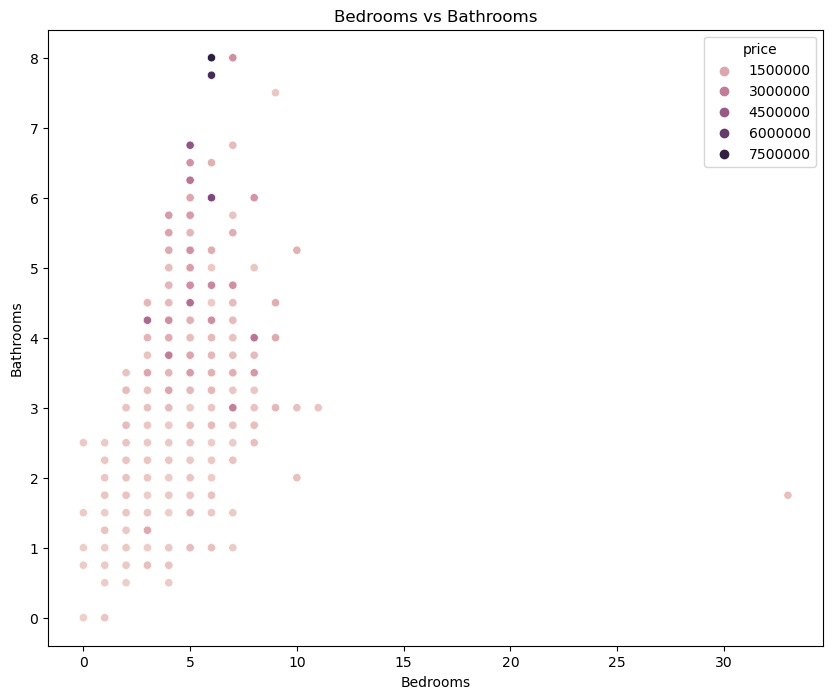

In [41]:
# Plotea cantidad de cuartos por cantidad de bannios
plt.figure(figsize=(10, 8))
sns.scatterplot(x='bedrooms', y='bathrooms', data=houses, hue='price')
plt.xlabel('Bedrooms')
plt.ylabel('Bathrooms')
plt.title('Bedrooms vs Bathrooms')
plt.show()

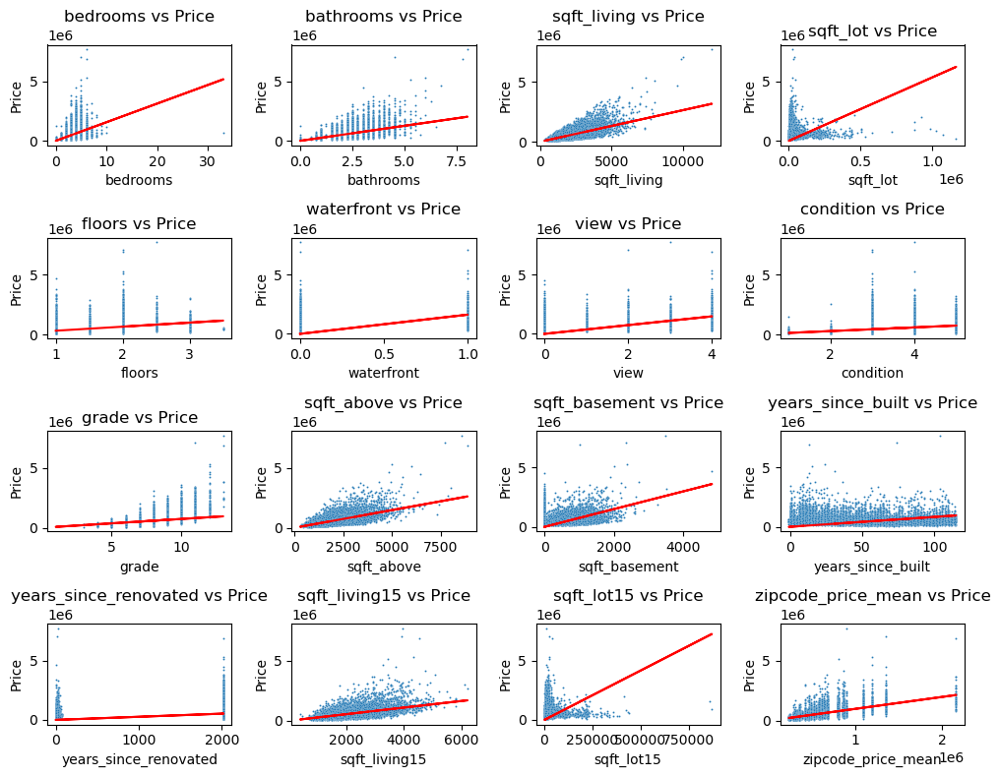

In [157]:
# Now for every variable plot the relation with the price, and for everyone do a regrresion a print the line, do it in a single image, but different tables


X = houses[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
            'waterfront', 'view', 'condition', 'grade', 'sqft_above',
            'sqft_basement', 'years_since_built', 'years_since_renovated', 'sqft_living15',
            'sqft_lot15', 'zipcode_price_mean']]
y = houses['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model, mse, r2, r2_adj = linear_regression(X_train, X_test, y_train, y_test,0)

plt.figure(figsize=(10, 8))
for i, column in enumerate(X.columns):
    plt.subplot(4, 4, i + 1)
    sns.scatterplot(x=X_train[column], y=y_train,s=2)
    plt.xlabel(column)
    plt.ylabel('Price')
    plt.title(f'{column} vs Price')
    plt.tight_layout()

    model = sm.OLS(y_train, X_train[column]).fit()
    plt.plot(X_train[column], model.predict(X_train[column]), color='red')

plt.show()

                            OLS Regression Results                            
Dep. Variable:              bathrooms   R-squared:                       0.266
Model:                            OLS   Adj. R-squared:                  0.266
Method:                 Least Squares   F-statistic:                     6251.
Date:                Sun, 07 Apr 2024   Prob (F-statistic):               0.00
Time:                        15:40:15   Log-Likelihood:                -17273.
No. Observations:               17290   AIC:                         3.455e+04
Df Residuals:                   17288   BIC:                         3.457e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.6849      0.019     36.530      0.0

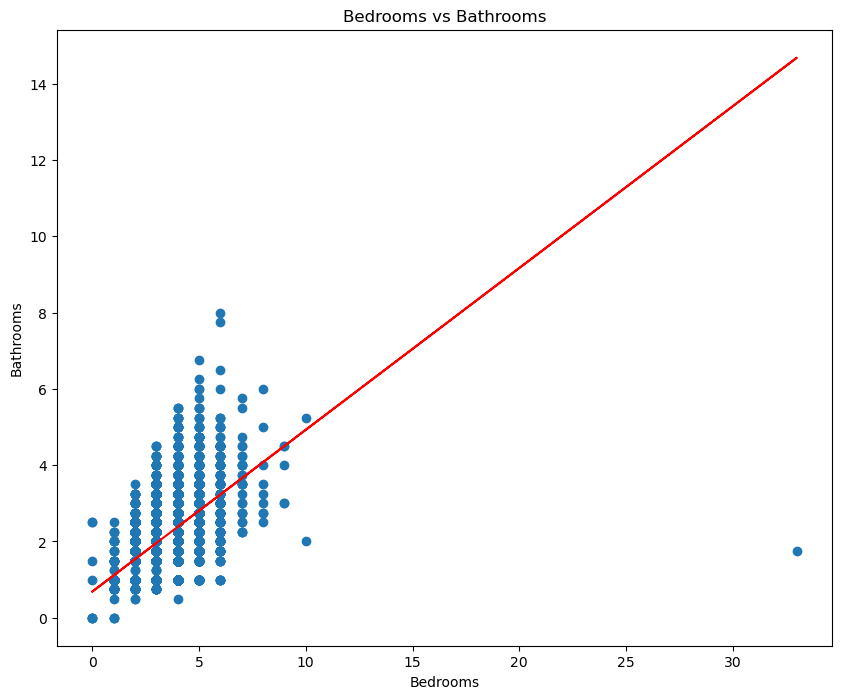

In [84]:
# Do a linear regresion to try to prove that the number of bathrooms is related to the number of bedrooms
X = houses[['bedrooms']]
y = houses['bathrooms']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train = sm.add_constant(X_train)
X_test = sm.add_constant(X_test)

model = sm.OLS(y_train, X_train).fit()
print(model.summary())

# Plot the regression line
plt.figure(figsize=(10, 8))
plt.scatter(X_train['bedrooms'], y_train)
plt.plot(X_train['bedrooms'], model.predict(X_train), color='red')
plt.xlabel('Bedrooms')
plt.ylabel('Bathrooms')
plt.title('Bedrooms vs Bathrooms')
plt.show()

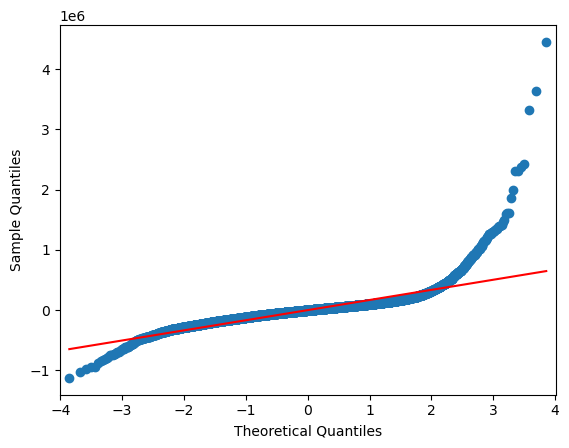

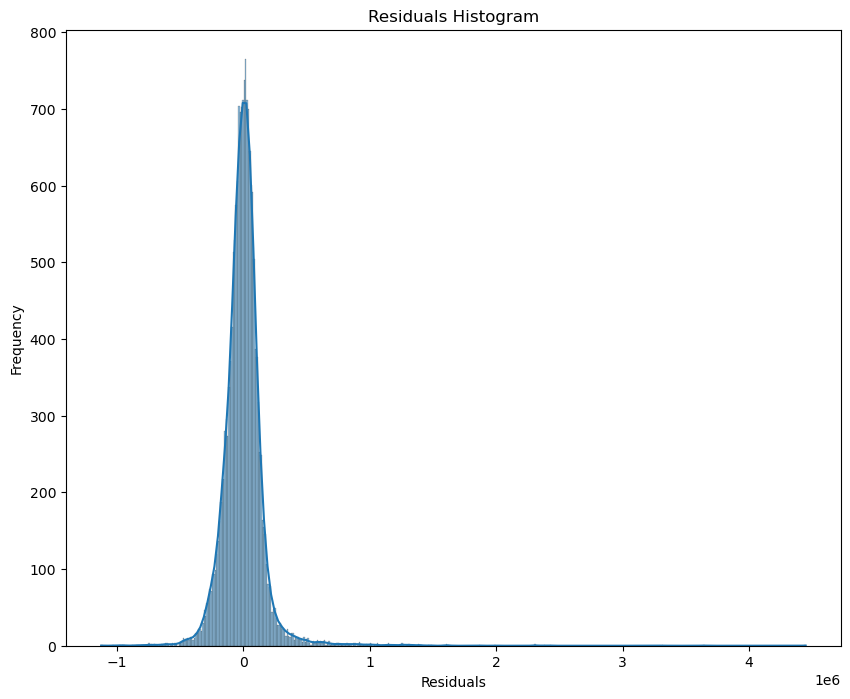

In [88]:
# Gráfico QQ de los residuos
residuals = model.resid
sm.qqplot(residuals, line='s')
plt.show()

# Histograma de los residuos

plt.figure(figsize=(10, 8))
sns.histplot(residuals, kde=True)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Residuals Histogram')
plt.show()


In [91]:
from scipy.stats import kstest
# Realizar la prueba del Kolmogorov-Smirnov para verificar la normalidad de los residuos
D, p_value = kstest(residuals, 'norm')

print(f"D = {D}, p-value = {p_value}")

if p_value > 0.05:
    print("Los residuos parecen estar normalmente distribuidos.")
else:
    print("Los residuos no parecen estar normalmente distribuidos.")


D = 0.5067090803932909, p-value = 0.0
Los residuos no parecen estar normalmente distribuidos.


Esto demuestra que el modelo no es el mejor para predecir el precio de las casas :(

In [95]:
from scipy.stats import normaltest
# Normality of Errors: Shapiro-Wilk Test (use for n<30) and Normality Test (use for n>=30)
_, norm_pvalue = normaltest(residuals)

print(f'Normality Test p-value: {norm_pvalue}')

# Interpretation
if p_value < 0.05:
    print("There is evidence to reject the null hypothesis that the values follow a normal distribution.")
else:
    print("There is not enough evidence to reject the null hypothesis that the values follow a normal distribution.")

Normality Test p-value: 0.0
There is evidence to reject the null hypothesis that the values follow a normal distribution.


In [92]:
from statsmodels.stats.stattools import durbin_watson

# Realizar el test de Durbin-Watson
dw_stat = durbin_watson(model.resid)

print(f"Estadística de Durbin-Watson: {dw_stat}")

# Interpretación de la estadística de Durbin-Watson
if 1.5 < dw_stat < 2.5:
    print("No hay autocorrelación en los residuos.")
elif dw_stat < 1.5:
    print("Hay autocorrelación positiva en los residuos.")
else:
    print("Hay autocorrelación negativa en los residuos.")

Estadística de Durbin-Watson: 1.9952952202050676
No hay autocorrelación en los residuos.


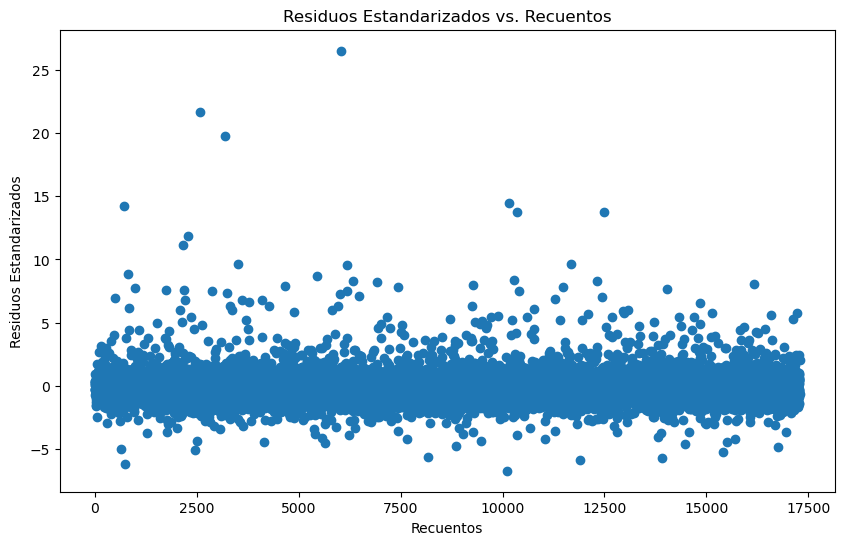

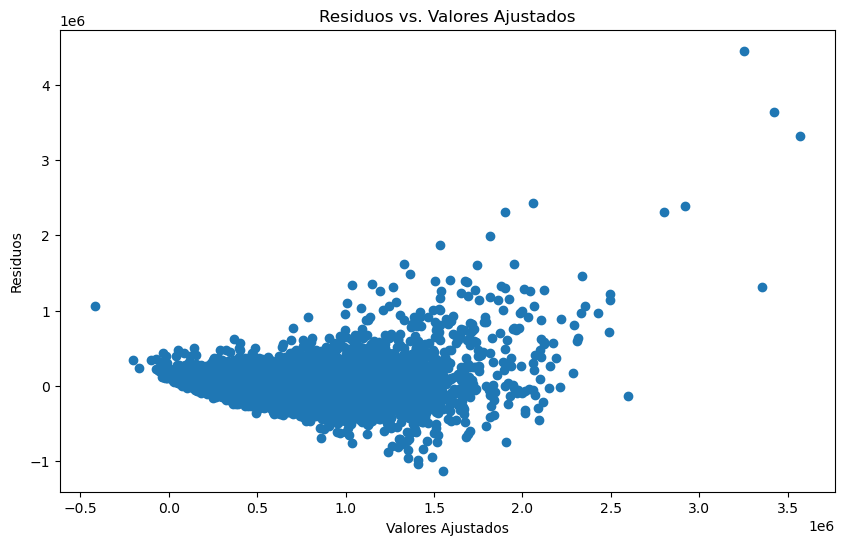

[('Lagrange multiplier statistic', 2076.281753843405), ('p-value', 0.0), ('f-value', 157.16381945814666), ('f p-value', 0.0)]


In [93]:
from statsmodels.compat import lzip
import statsmodels.stats.api as sms

# Calcular los residuos estandarizados
residuos_estandarizados = residuals / np.std(residuals)

# Gráfico de residuos estandarizados contra recuentos
plt.figure(figsize=(10, 6))
plt.scatter(range(len(residuos_estandarizados)), residuos_estandarizados)
plt.title('Residuos Estandarizados vs. Recuentos')
plt.xlabel('Recuentos')
plt.ylabel('Residuos Estandarizados')
plt.show()

# Gráfico de residuos vs. valores ajustados
plt.figure(figsize=(10, 6))
plt.scatter(model.fittedvalues, residuals)
plt.title('Residuos vs. Valores Ajustados')
plt.xlabel('Valores Ajustados')
plt.ylabel('Residuos')
plt.show()


# Realizar el test de Breusch-Pagan
names = ['Lagrange multiplier statistic', 'p-value', 'f-value', 'f p-value']
test = sms.het_breuschpagan(model.resid, model.model.exog)

# Imprimir los resultados del test
print(lzip(names, test))

# PCA

In [109]:
# Do PCA to the data, and plot the explained variance of the components

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

houses_normalized = houses_numeric.dropna()

# Estandarizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(houses_normalized)

# Crear el objeto PCA
pca = PCA()

# Ajustar el PCA a los datos
pca.fit(X_scaled)

# Obtener los componentes principales
components = pca.transform(X_scaled)

<BarContainer object of 23 artists>

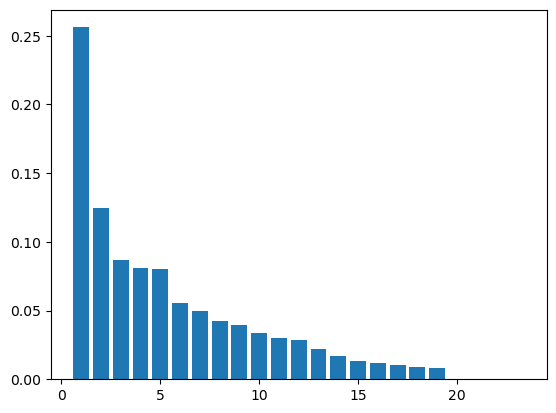

In [110]:
variance_ratio = pca.explained_variance_ratio_
plt.bar(np.arange(variance_ratio.shape[0]) + 1, variance_ratio)

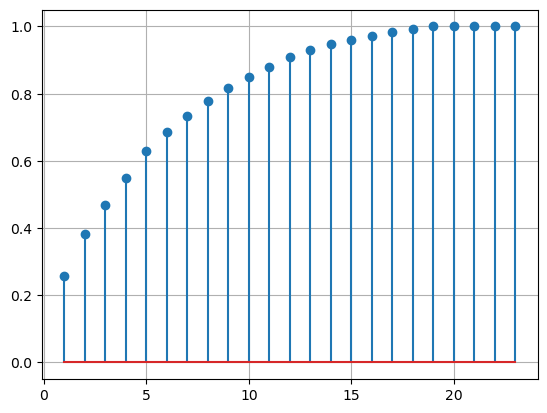

In [111]:
cum_variance = pca.explained_variance_ratio_.cumsum()
plt.stem(np.arange(variance_ratio.shape[0]) + 1, cum_variance)
plt.grid()

In [122]:
component_count = 10
pca = PCA(component_count)
principalComponents = pca.fit_transform(houses_normalized)
principal_Df = pd.DataFrame(data = principalComponents)
analysis = pd.DataFrame(pca.components_, columns=houses_normalized.columns, index=[f'PC{i}' for i in range(1,component_count+1)]).T
analysis

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
id,1.000000e+00,2.166247e-06,2.278976e-06,-2.113614e-07,-1.060835e-08,2.491745e-09,-2.507960e-10,1.519750e-09,2.082783e-10,-2.940425e-12
price,-2.139340e-06,9.999282e-01,-1.171662e-02,3.506154e-04,-2.394681e-03,-4.352692e-04,-4.284150e-04,2.411097e-06,-3.456455e-05,2.031559e-08
bedrooms,4.008625e-13,7.815072e-07,9.712359e-08,-4.585158e-08,4.437893e-04,1.155051e-04,3.689710e-04,3.270639e-04,1.346185e-03,9.388736e-02
bathrooms,1.380958e-12,1.102201e-06,7.695674e-07,-6.131845e-07,4.211693e-04,9.291859e-05,1.637768e-04,2.366153e-04,-6.597811e-03,-1.830771e-03
sqft_living,-3.914198e-09,1.756596e-03,2.431079e-03,-2.415989e-03,6.303628e-01,1.324928e-01,3.745727e-01,3.337186e-01,8.177672e-03,6.411981e-06
sqft_lot,-1.902272e-06,1.002783e-02,8.707607e-01,4.916026e-01,-1.244663e-03,-4.807217e-05,2.433147e-04,-7.394372e-04,-2.599909e-05,-2.300180e-07
floors,3.477270e-12,3.781817e-07,-3.369653e-07,3.451901e-07,2.068583e-04,-2.465883e-05,-3.726766e-04,1.861724e-04,-4.653390e-03,-1.643184e-02
waterfront,-8.184512e-14,6.277534e-08,1.150355e-09,-7.765757e-08,-1.163441e-05,6.579960e-06,-2.361330e-06,-3.613188e-06,-7.908326e-05,-1.142261e-03
view,3.088068e-12,8.300026e-07,7.380803e-07,-4.368819e-07,-2.734537e-05,9.049373e-05,2.297390e-04,-2.152655e-04,7.436778e-04,-1.173135e-02
condition,-5.380367e-12,6.371758e-08,-2.097580e-07,-1.872475e-07,-1.269302e-04,-7.113570e-05,2.323486e-04,3.740801e-05,5.840678e-03,-7.271221e-02


<Axes: >

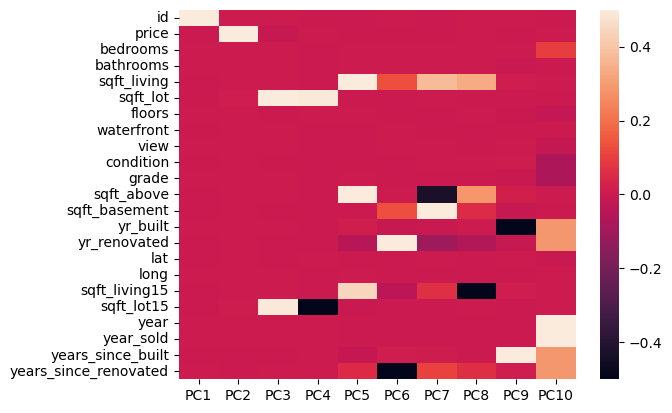

In [123]:
sns.heatmap(analysis, vmin=-5e-1, vmax=5e-1)

In [ ]:
# Create a torch model to predict the price of the houses
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# Convertir los datos a tensores de PyTorch
X_tensor = torch.tensor(X_scaled, dtype=torch.float32)
y_tensor = torch.tensor(houses['price'].values, dtype=torch.float32)

# Crear un DataLoader
dataset = TensorDataset(X_tensor, y_tensor)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

# Definir la arquitectura de la red neuronal
class HousePricePredictor(nn.Module):
    def __init__(self):
        super(HousePricePredictor, self).__init__()
        self.fc1 = nn.Linear(16, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 1)
    
    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return x

# Crear el modelo
model = HousePricePredictor()

# Definir la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenar el modelo
num_epochs = 100
for epoch in range(num_epochs):
    for X_batch, y_batch in dataloader:
        optimizer.zero_grad()
        y_pred = model(X_batch)
        loss = criterion(y_pred.view(-1), y_batch)
        loss.backward()
        optimizer.step()
    
    if epoch % 10 == 0:
        print(f'Epoch {epoch + 1}/{num_epochs}, Loss: {loss.item()}')

# Calcular el error cuadrático medio
y_pred = model(X_tensor).detach().numpy()
mse = mean_squared_error(y_pred, y_tensor)
print(f'MSE: {mse}') 

In [142]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import numpy as np

def train_pytorch_model(X_train, X_test, y_train, y_test):
    # Convert the data to PyTorch tensors
    X_train_tensor = torch.tensor(X_train.values, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
    X_test_tensor = torch.tensor(X_test.values, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)

    # Create a DataLoader
    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    train_dataloader = DataLoader(train_dataset, batch_size=64, shuffle=True)

    # Define the neural network architecture
    class HousePricePredictor(nn.Module):
        def __init__(self):
            super(HousePricePredictor, self).__init__()
            self.fc1 = nn.Linear(X_train.shape[1], 64)
            self.fc2 = nn.Linear(64, 64)
            self.fc3 = nn.Linear(64, 32)
            self.fc4 = nn.Linear(32, 1)

        def forward(self, x):
            x = torch.relu(self.fc1(x))
            x = torch.relu(self.fc2(x))
            x = torch.relu(self.fc3(x))
            x = self.fc4(x)
            return x

    # Create the model
    model = HousePricePredictor()

    # Define the loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Train the model with simple early stopping
    best_loss = np.inf
    patience = 50
    patience_counter = 0

    num_epochs = 200
    for epoch in range(num_epochs):
        model.train()
        for X_batch, y_batch in train_dataloader:
            optimizer.zero_grad()
            y_pred = model(X_batch)
            loss = criterion(y_pred.view(-1), y_batch)
            loss.backward()
            optimizer.step()

        # Print loss every 10 epochs
        if epoch % 10 == 0:
            print(f'Epoch {epoch + 1}/{num_epochs}, Loss: {loss.item()}')

        # Early stopping logic
        if loss.item() < best_loss:
            best_loss = loss.item()
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print("Early stopping triggered")
                break

    # Calculate Mean Squared Error
    model.eval()
    y_pred_tensor = model(X_test_tensor)
    y_pred = y_pred_tensor.view(-1).detach().numpy()
    mse = mean_squared_error(y_test, y_pred)
    print(f'MSE: {mse}')

    return model, mse

Epoch 1/200, Loss: 33446356992.0
Epoch 11/200, Loss: 149531099136.0
Epoch 21/200, Loss: 44068925440.0
Epoch 31/200, Loss: 24577077248.0
Epoch 41/200, Loss: 30308276224.0
Epoch 51/200, Loss: 15695637504.0
Epoch 61/200, Loss: 22672035840.0
Epoch 71/200, Loss: 53657833472.0
Epoch 81/200, Loss: 34726436864.0
Epoch 91/200, Loss: 42030096384.0
Epoch 101/200, Loss: 25949966336.0
Epoch 111/200, Loss: 190211162112.0
Epoch 121/200, Loss: 46555713536.0
Epoch 131/200, Loss: 14151354368.0
Epoch 141/200, Loss: 54839386112.0
Early stopping triggered
MSE: 51069433916.609474
MSE: 51069433916.609474


In [133]:
def train_xgboost_model(X_train, X_test, y_train, y_test):
    model = xgb.XGBRegressor(objective='reg:squarederror')
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_pred, y_test)
    print(f'MSE: {mse}')

    return model, mse

ModuleNotFoundError: No module named 'xgboost'